# Audio Filters in Python

1. Overview of Filter Types
2. Implementation and Application of Low-pass, High-pass, Band-pass, and Notch Filters
3. Introduction to All-pass, Shelving, and Bell Filters
4. Practical Examples and Audio Playback
5. Frequency Analysis and Visualization

<hr>

## Filter Types

We will explore the following filter types:
<ul> 
    <li>Low-pass Filter</li> 
    <li>High-pass Filter</li> 
    <li>Band-pass Filter</li> 
    <li>Notch Filter</li> 
    <li>All-pass Filter</li> 
    <li>Shelving Filter</li> 
    <li>Bell Filter</li> 
</ul> 



## Loading and Playing Audio Files

In this section, we will load and play audio files in Python. We will use the `librosa` library for loading the audio files and `IPython.display` for playback.


In [1]:
# Importing the necessary libraries
import librosa
import IPython.display as ipd
import numpy as np

# Loading a sample audio file
y1, sr1 = librosa.load(librosa.example('choice'), duration=15.0)  # Loading a Choice audio sample
y2, sr2 = librosa.load(librosa.example('brahms'), duration=15.0)  # Loading a Brahms audio sample

# Creating white noise and trimming it to 15 seconds
sr3 = 22050  # Sampling rate
duration = 15  # Duration in seconds
y3 = np.random.randn(sr3 * duration)  # Generating white noise

# Uncomment to load a local audio file
#y_local, sr_local = librosa.load('path/to/your/local/file.wav')  # Replace with the actual path to your file

# Audio playback
print("Choice Sample")
ipd.display(ipd.Audio(data=y1, rate=sr1))
print("Brahms Sample")
ipd.display(ipd.Audio(data=y2, rate=sr2))
print("White Noise")
ipd.display(ipd.Audio(data=y3, rate=sr3))
# Uncomment below to play your local audio file
# print("Local File")
# ipd.display(ipd.Audio(data=y_local, rate=sr_local))


Choice Sample


Brahms Sample


White Noise


## Implementation and Application of Filters

In this section, we will implement various types of filters and apply them to our audio files. We use `numpy`, `matplotlib`, `butter` and `lfilter`.

<h3>Low-pass Filter</h3>
A low-pass filter allows low frequencies to pass through while attenuating high frequencies.

<h3>High-pass Filter</h3>
A high-pass filter allows high frequencies to pass through while attenuating low frequencies.

<h3>Band-pass Filter</h3>
A band-pass filter allows a specific range of frequencies to pass through while attenuating frequencies outside that range.

<h3>Notch Filter</h3>
A notch filter attenuates a very narrow range of frequencies while allowing the remaining frequencies to pass through.


In [12]:
# Importing the necessary libraries
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import butter, lfilter

# Function to create a low-pass filter
def butter_lowpass(cutoff, fs, order=5):
    """
    Creates a low-pass Butterworth filter.

    Args:
        cutoff (float): Cutoff frequency in Hz
        fs (float): Sampling rate in Hz
        order (int): Filter order (default is 5)

    Returns:
        tuple: Numerator (b) and denominator (a) coefficients of the filter
    """
    nyquist = 0.5 * fs  # Nyquist frequency (half of the sampling rate)
    normalized_cutoff = cutoff / nyquist  # Normalized cutoff frequency
    b, a = butter(order, normalized_cutoff, btype='low', analog=False)  # Calculate Butterworth filter coefficients
    return b, a

# Function to apply a low-pass filter
def lowpass_filter(data, cutoff, fs, order=5):
    """
    Applies a low-pass Butterworth filter to the input signal.

    Args:
        data (ndarray): Input audio signal
        cutoff (float): Cutoff frequency in Hz
        fs (float): Sampling rate in Hz
        order (int): Filter order (default is 5)

    Returns:
        ndarray: Filtered audio signal
    """
    b, a = butter_lowpass(cutoff, fs, order=order)
    y = lfilter(b, a, data)
    return y

# Function to create a high-pass filter
def butter_highpass(cutoff, fs, order=5):
    """
    Creates a high-pass Butterworth filter.

    Args:
        cutoff (float): Cutoff frequency in Hz
        fs (float): Sampling rate in Hz
        order (int): Filter order (default is 5)

    Returns:
        tuple: Numerator (b) and denominator (a) coefficients of the filter
    """
    nyquist = 0.5 * fs
    normalized_cutoff = cutoff / nyquist
    b, a = butter(order, normalized_cutoff, btype='high', analog=False)
    return b, a

# Function to apply a high-pass filter
def highpass_filter(data, cutoff, fs, order=5):
    """
    Applies a high-pass Butterworth filter to the input signal.

    Args:
        data (ndarray): Input audio signal
        cutoff (float): Cutoff frequency in Hz
        fs (float): Sampling rate in Hz
        order (int): Filter order (default is 5)

    Returns:
        ndarray: Filtered audio signal
    """
    b, a = butter_highpass(cutoff, fs, order=order)
    y = lfilter(b, a, data)
    return y

# Function to create a band-pass filter
def butter_bandpass(lowcut, highcut, fs, order=5):
    """
    Creates a band-pass Butterworth filter.

    Args:
        lowcut (float): Lower cutoff frequency in Hz
        highcut (float): Upper cutoff frequency in Hz
        fs (float): Sampling rate in Hz
        order (int): Filter order (default is 5)

    Returns:
        tuple: Numerator (b) and denominator (a) coefficients of the filter
    """
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    return b, a

# Function to apply a band-pass filter
def bandpass_filter(data, lowcut, highcut, fs, order=5):
    """
    Applies a band-pass Butterworth filter to the input signal.

    Args:
        data (ndarray): Input audio signal
        lowcut (float): Lower cutoff frequency in Hz
        highcut (float): Upper cutoff frequency in Hz
        fs (float): Sampling rate in Hz
        order (int): Filter order (default is 5)

    Returns:
        ndarray: Filtered audio signal
    """
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = lfilter(b, a, data)
    return y

# Function to create a notch filter (band-stop filter)
def butter_bandstop(lowcut, highcut, fs, order=5):
    """
    Creates a band-stop (notch) Butterworth filter.

    Args:
        lowcut (float): Lower cutoff frequency in Hz
        highcut (float): Upper cutoff frequency in Hz
        fs (float): Sampling rate in Hz
        order (int): Filter order (default is 5)

    Returns:
        tuple: Numerator (b) and denominator (a) coefficients of the filter
    """
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='bandstop')
    return b, a

# Function to apply a notch filter
def bandstop_filter(data, lowcut, highcut, fs, order=5):
    """
    Applies a band-stop (notch) Butterworth filter to the input signal.

    Args:
        data (ndarray): Input audio signal
        lowcut (float): Lower cutoff frequency in Hz
        highcut (float): Upper cutoff frequency in Hz
        fs (float): Sampling rate in Hz
        order (int): Filter order (default is 5)

    Returns:
        ndarray: Filtered audio signal
    """
    b, a = butter_bandstop(lowcut, highcut, fs, order=order)
    y = lfilter(b, a, data)
    return y


## Applying Filters

<ol>
  <li>Apply the filters to the Choice audio file.</li>
  <li>Play back the filtered audio signals.</li>
</ol>



In [13]:
# Parameters for the filters
cutoff = 3500.0  # Cutoff frequency in Hz
lowcut = 3000.0  # Lower cutoff frequency for the band-pass filter
highcut = 6000.0  # Upper cutoff frequency for the band-pass filter

# Apply the filters to the choice audio file
filtered_lp = lowpass_filter(y1, cutoff, sr1)
filtered_lp_wn = lowpass_filter(y3, cutoff, sr3)
filtered_hp = highpass_filter(y1, cutoff, sr1)
filtered_hp_wn = highpass_filter(y3, cutoff, sr3)
filtered_bp = bandpass_filter(y1, lowcut, highcut, sr1)
filtered_bp_wn = bandpass_filter(y3, lowcut, highcut, sr3)
filtered_bs = bandstop_filter(y1, lowcut, highcut, sr1)
filtered_bs_wn = bandstop_filter(y3, lowcut, highcut, sr3)

# Play back the filtered audio signals
print("Low-pass Filter (Choice Sample)")
ipd.display(ipd.Audio(data=filtered_lp, rate=sr1))

print("Low-pass Filter (White Noise)")
ipd.display(ipd.Audio(data=filtered_lp_wn, rate=sr3))

print("High-pass Filter (Choice Sample)")
ipd.display(ipd.Audio(data=filtered_hp, rate=sr1))

print("High-pass Filter (White Noise)")
ipd.display(ipd.Audio(data=filtered_hp_wn, rate=sr3))

print("Band-pass Filter (Choice Sample)")
ipd.display(ipd.Audio(data=filtered_bp, rate=sr1))

print("Band-pass Filter (White Noise)")
ipd.display(ipd.Audio(data=filtered_bp_wn, rate=sr3))

print("Notch Filter (Choice Sample)")
ipd.display(ipd.Audio(data=filtered_bs, rate=sr1))

print("Notch Filter (White Noise)")
ipd.display(ipd.Audio(data=filtered_bs_wn, rate=sr3))


Low-pass Filter (Choice Sample)


Low-pass Filter (White Noise)


High-pass Filter (Choice Sample)


High-pass Filter (White Noise)


Band-pass Filter (Choice Sample)


Band-pass Filter (White Noise)


Notch Filter (Choice Sample)


Notch Filter (White Noise)


## Advanced Filter Types: All-pass, Shelving, and Bell Filters

In addition to the filters mentioned above, there are other useful filter types such as the All-pass, Shelving, and Bell filters.

<h3>All-pass Filter</h3>
An All-pass filter allows all frequencies to pass through while altering the phase of the signal.

<h3>Shelving Filter</h3>
A Shelving filter boosts or attenuates all frequencies above or below a specified frequency by a fixed amount.

<h3>Bell Filter</h3>
A Bell filter boosts or attenuates frequencies around a specific central frequency.

In [4]:
from scipy.signal import sosfilt, butter, iirpeak, lfilter

# Function to create and apply a low-shelf filter
def shelving_filter_low(data, gain, cutoff, fs, order=2):
    """
    Creates a low-shelf filter and applies it to the input signal.

    Args:
        data (ndarray): Input audio signal
        gain (float): Gain in dB
        cutoff (float): Cutoff frequency in Hz
        fs (float): Sampling rate in Hz
        order (int): Filter order (default is 2)

    Returns:
        ndarray: Filtered audio signal
    """
    nyquist = 0.5 * fs  # Nyquist frequency (half the sampling rate)
    normalized_cutoff = cutoff / nyquist  # Normalized cutoff frequency
    sos = butter(order, normalized_cutoff, btype='low', analog=False, output='sos')  # Compute filter coefficients
    y = sosfilt(sos, data) * (10**(gain / 20.0))  # Apply the filter and adjust gain
    return y

# Function to create and apply a high-shelf filter
def shelving_filter_high(data, gain, cutoff, fs, order=2):
    """
    Creates a high-shelf filter and applies it to the input signal.

    Args:
        data (ndarray): Input audio signal
        gain (float): Gain in dB
        cutoff (float): Cutoff frequency in Hz
        fs (float): Sampling rate in Hz
        order (int): Filter order (default is 2)

    Returns:
        ndarray: Filtered audio signal
    """
    nyquist = 0.5 * fs  # Nyquist frequency
    normalized_cutoff = cutoff / nyquist  # Normalized cutoff frequency
    sos = butter(order, normalized_cutoff, btype='high', analog=False, output='sos')  # Compute filter coefficients
    y = sosfilt(sos, data) * (10**(gain / 20.0))  # Apply the filter and adjust gain
    return y

# Function to create and apply a Bell (peaking EQ) filter
def bell_filter(data, center_freq, gain, q, fs):
    """
    Creates a Bell filter (peaking EQ) and applies it to the input signal.

    Args:
        data (ndarray): Input audio signal
        center_freq (float): Center frequency in Hz
        gain (float): Gain in dB
        q (float): Quality factor
        fs (float): Sampling rate in Hz

    Returns:
        ndarray: Filtered audio signal
    """
    nyquist = 0.5 * fs  # Nyquist frequency
    normalized_center = center_freq / nyquist  # Normalized center frequency
    b, a = iirpeak(normalized_center, q)  # Compute filter coefficients
    y = lfilter(b, a, data) * (10**(gain / 20.0))  # Apply the filter and adjust gain
    return y

# All-pass filter using a direct method (first-order)
def allpass_filter(data, cutoff, fs, q=0.707):
    """
    Creates an all-pass filter and applies it to the input signal.

    Args:
        data (ndarray): Input audio signal
        cutoff (float): Center frequency in Hz
        fs (float): Sampling rate in Hz
        q (float): Quality factor (default is 0.707)

    Returns:
        ndarray: Phase-altered audio signal
    """
    # Calculate normalized frequency
    w0 = 2 * np.pi * cutoff / fs
    a = (1 - np.tan(w0 / 2)) / (1 + np.tan(w0 / 2))  # Coefficient for all-pass filter

    # Filter coefficients for a first-order all-pass filter
    b = [a, 1]
    a = [1, a]
    
    # Apply the filter to the signal
    y = lfilter(b, a, data)
    return y


## Applying All-pass, Shelving, and Bell Filters

<ol>
  <li>Apply the filters to the Choice audio file.</li>
  <li>Play back the filtered audio signals.</li>
</ol>
<hr>

In [5]:
# Parameters for the filters
gain = 6.0  # Gain in dB
center_freq = 1500.0  # Center frequency in Hz
q = 6.707  # Quality factor

# Apply the filters to the trumpet audio file
filtered_allpass = allpass_filter(y1, cutoff, sr1, q)
filtered_allpass_wn = allpass_filter(y3, cutoff, sr3, q)
filtered_shelving_low = shelving_filter_low(y1, gain, cutoff, sr1)
filtered_shelving_low_wn = shelving_filter_low(y3, gain, cutoff, sr3)
filtered_shelving_high = shelving_filter_high(y1, gain, cutoff, sr1)
filtered_shelving_high_wn = shelving_filter_high(y3, gain, cutoff, sr3)
filtered_bell = bell_filter(y1, center_freq, gain, q, sr1)
filtered_bell_wn = bell_filter(y3, center_freq, gain, q, sr3)

# Playback of the filtered signals
print("All-pass Filter")
ipd.display(ipd.Audio(data=filtered_allpass, rate=sr1))

print("All-pass Filter (White Noise)")
ipd.display(ipd.Audio(data=filtered_allpass_wn, rate=sr3))

print("Low-shelf Filter")
ipd.display(ipd.Audio(data=filtered_shelving_low, rate=sr1))

print("Low-shelf Filter (White Noise)")
ipd.display(ipd.Audio(data=filtered_shelving_low_wn, rate=sr3))

print("High-shelf Filter")
ipd.display(ipd.Audio(data=filtered_shelving_high, rate=sr1))

print("High-shelf Filter (White Noise)")
ipd.display(ipd.Audio(data=filtered_shelving_high_wn, rate=sr3))

print("Bell Filter")
ipd.display(ipd.Audio(data=filtered_bell, rate=sr1))

print("Bell Filter (White Noise)")
ipd.display(ipd.Audio(data=filtered_bell_wn, rate=sr3))


All-pass Filter


All-pass Filter (White Noise)


Low-shelf Filter


Low-shelf Filter (White Noise)


High-shelf Filter


High-shelf Filter (White Noise)


Bell Filter


Bell Filter (White Noise)


## Visualization of Filter Types

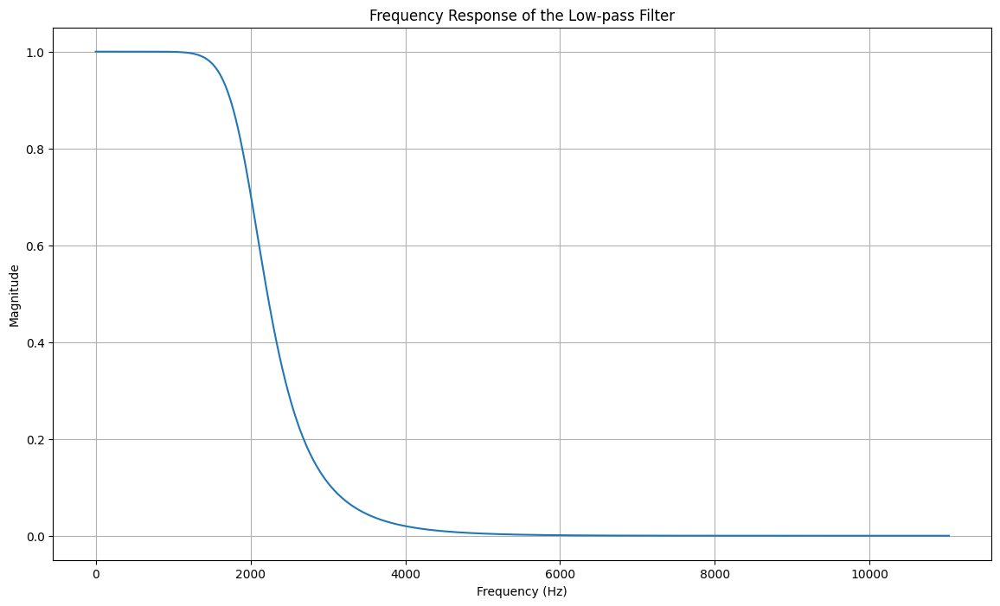

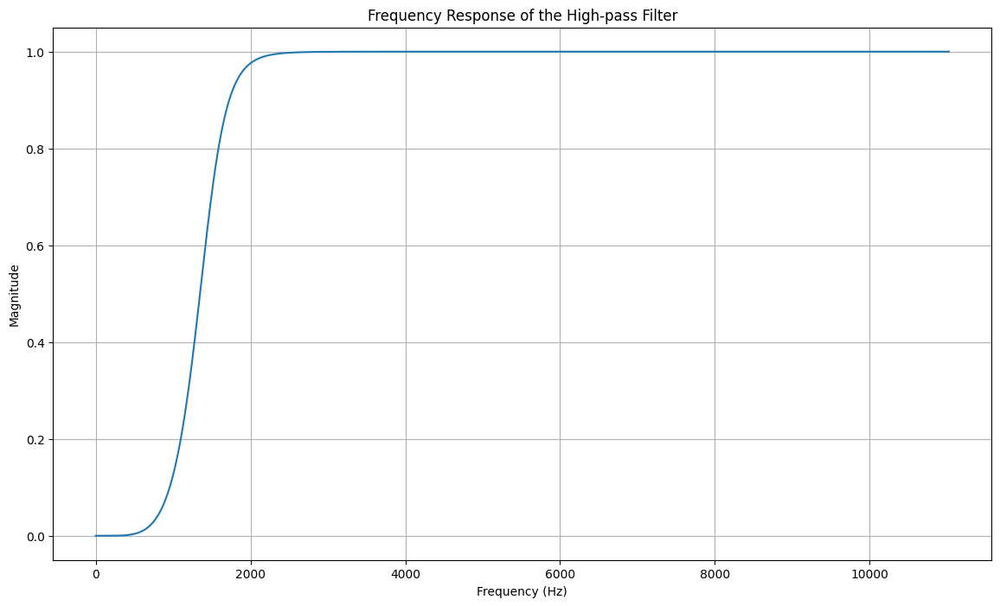

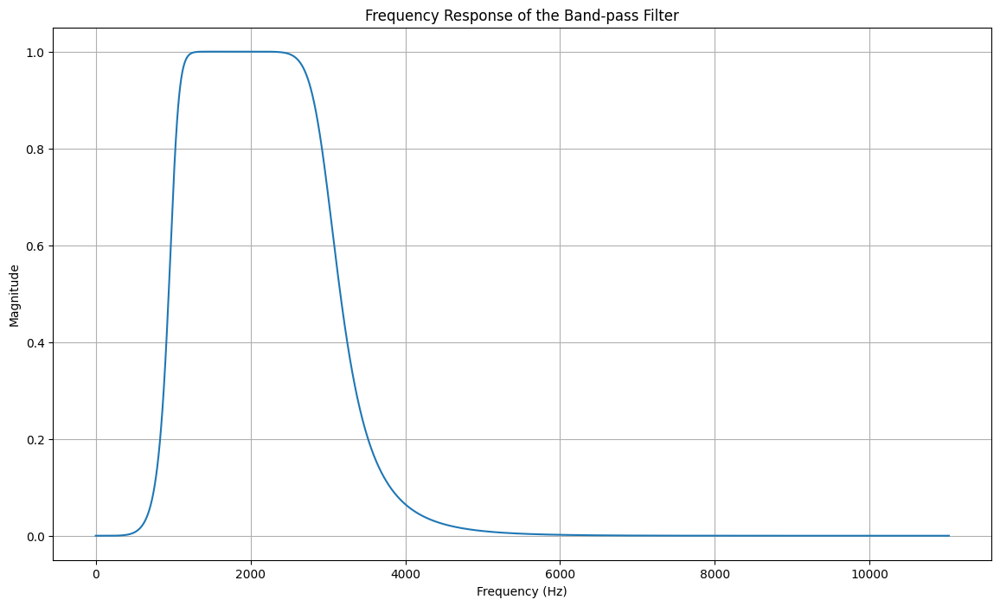

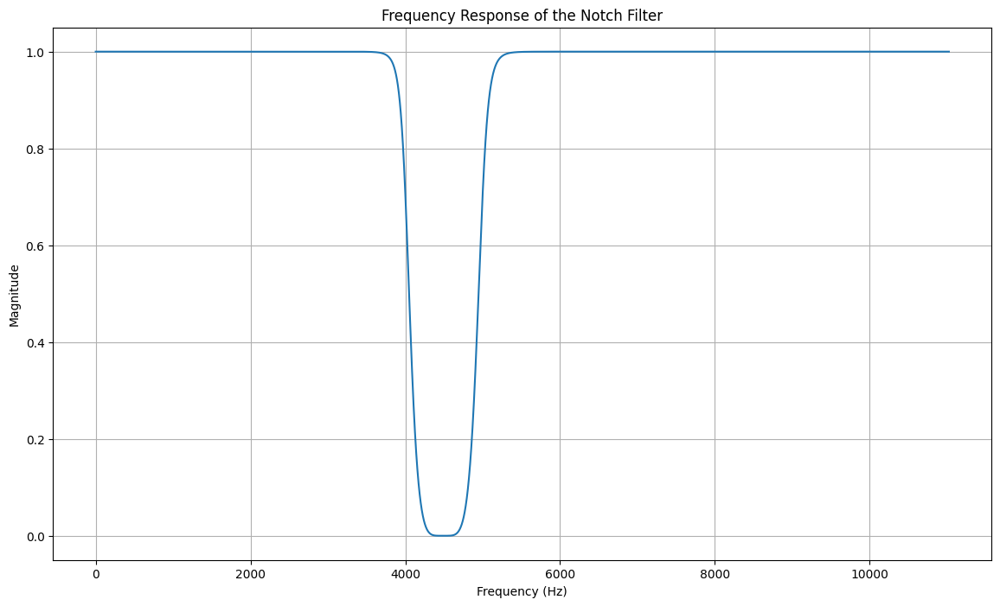

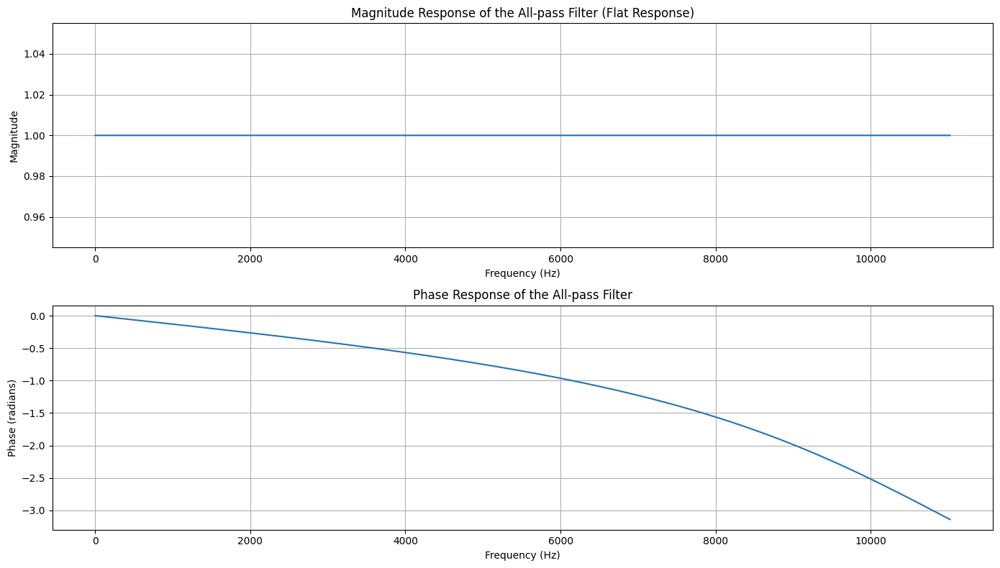

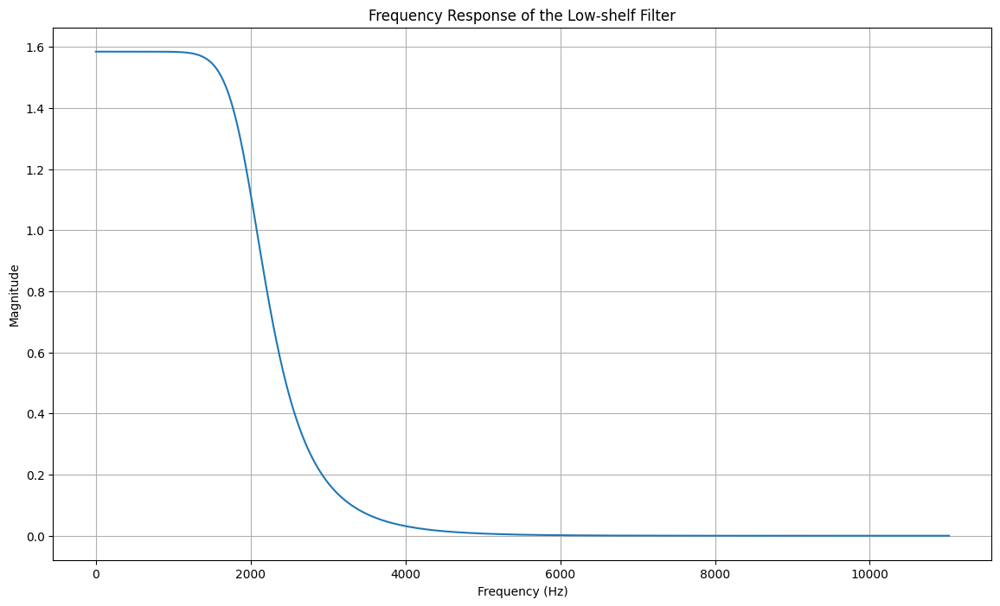

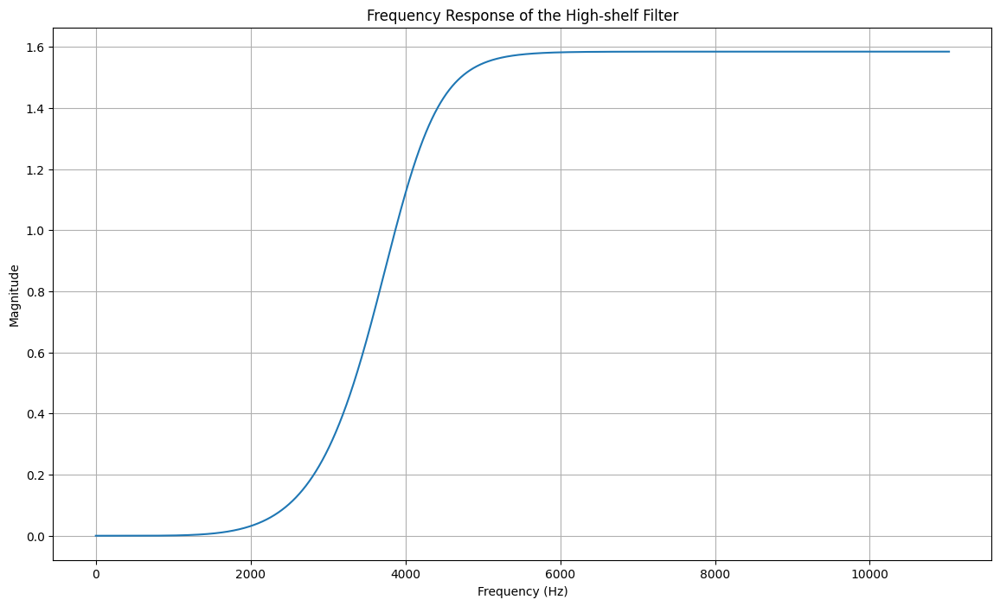

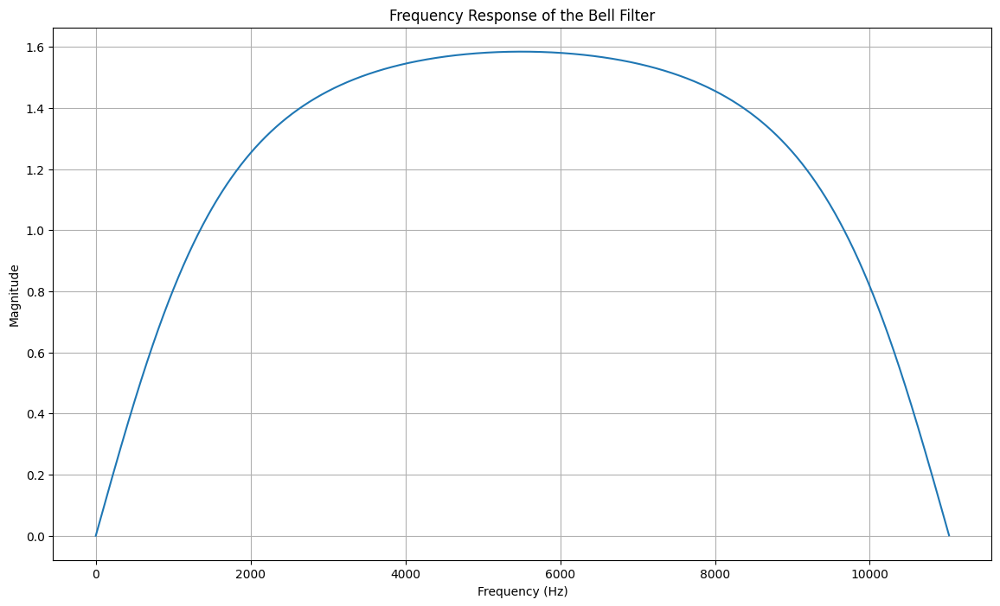

In [6]:
from scipy.signal import butter, sosfilt, sosfreqz, freqz, iirnotch, iirpeak
import matplotlib.pyplot as plt
import numpy as np

# Function to visualize the frequency responses of various filters
def plot_individual_filter_responses(fs, order, cutoff_lp, cutoff_hp, lowcut_bp, highcut_bp, lowcut_bs, highcut_bs, allpass_freq, shelving_low_freq, shelving_high_freq, bell_freq, q, gain):
    nyquist = 0.5 * fs

    # Frequency response for Low-pass filter
    b_lp, a_lp = butter(order, cutoff_lp / nyquist, btype='low', analog=False)
    w_lp, h_lp = freqz(b_lp, a_lp, worN=8000)
    plt.figure(figsize=(14, 8))
    plt.plot(0.5 * fs * w_lp / np.pi, np.abs(h_lp))
    plt.title('Frequency Response of the Low-pass Filter')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Magnitude')
    plt.grid()
    plt.show()

    # Frequency response for High-pass filter
    b_hp, a_hp = butter(order, cutoff_hp / nyquist, btype='high', analog=False)
    w_hp, h_hp = freqz(b_hp, a_hp, worN=8000)
    plt.figure(figsize=(14, 8))
    plt.plot(0.5 * fs * w_hp / np.pi, np.abs(h_hp))
    plt.title('Frequency Response of the High-pass Filter')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Magnitude')
    plt.grid()
    plt.show()

    # Frequency response for Band-pass filter
    b_bp, a_bp = butter(order, [lowcut_bp / nyquist, highcut_bp / nyquist], btype='band')
    w_bp, h_bp = freqz(b_bp, a_bp, worN=8000)
    plt.figure(figsize=(14, 8))
    plt.plot(0.5 * fs * w_bp / np.pi, np.abs(h_bp))
    plt.title('Frequency Response of the Band-pass Filter')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Magnitude')
    plt.grid()
    plt.show()

    # Frequency response for Notch filter (Band-stop filter)
    b_bs, a_bs = butter(order, [lowcut_bs / nyquist, highcut_bs / nyquist], btype='bandstop')
    w_bs, h_bs = freqz(b_bs, a_bs, worN=8000)
    plt.figure(figsize=(14, 8))
    plt.plot(0.5 * fs * w_bs / np.pi, np.abs(h_bs))
    plt.title('Frequency Response of the Notch Filter')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Magnitude')
    plt.grid()
    plt.show()

    # Frequency response for All-pass filter
    w0 = 2 * np.pi * allpass_freq / fs  # Normalized frequency
    a = (1 - np.tan(w0 / 2)) / (1 + np.tan(w0 / 2))  # Coefficients for the All-pass filter

    # All-pass filter coefficients
    b_ap = [a, 1]
    a_ap = [1, a]

    # Calculate the frequency response
    w_ap, h_ap = freqz(b_ap, a_ap, worN=8000)

    # Plot the magnitude response (should remain flat)
    plt.figure(figsize=(14, 8))

    # Magnitude response plot 
    plt.subplot(2, 1, 1)
    plt.plot(0.5 * fs * w_ap / np.pi, np.abs(h_ap))
    plt.title('Magnitude Response of the All-pass Filter (Flat Response)')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Magnitude')
    plt.grid()

    # Phase response plot (phase shift across frequencies)
    plt.subplot(2, 1, 2)
    plt.plot(0.5 * fs * w_ap / np.pi, np.unwrap(np.angle(h_ap)))
    plt.title('Phase Response of the All-pass Filter')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Phase (radians)')
    plt.grid()

    # Show both magnitude and phase response in one figure
    plt.tight_layout()
    plt.show()

    # Frequency response for Low-shelf filter
    sos = butter(order, shelving_low_freq / nyquist, btype='low', analog=False, output='sos')
    w_shl, h_shl = sosfreqz(sos, worN=8000)
    plt.figure(figsize=(14, 8))
    plt.plot(0.5 * fs * w_shl / np.pi, np.abs(h_shl) * (10**(gain / 20.0)))
    plt.title('Frequency Response of the Low-shelf Filter')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Magnitude')
    plt.grid()
    plt.show()

    # Frequency response for High-shelf filter
    sos = butter(order, shelving_high_freq / nyquist, btype='high', analog=False, output='sos')
    w_shh, h_shh = sosfreqz(sos, worN=8000)
    plt.figure(figsize=(14, 8))
    plt.plot(0.5 * fs * w_shh / np.pi, np.abs(h_shh) * (10**(gain / 20.0)))
    plt.title('Frequency Response of the High-shelf Filter')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Magnitude')
    plt.grid()
    plt.show()

    # Frequency response for Bell filter
    b_bell, a_bell = iirpeak(bell_freq / nyquist, q)
    w_bell, h_bell = freqz(b_bell, a_bell, worN=8000)
    plt.figure(figsize=(14, 8))
    plt.plot(0.5 * fs * w_bell / np.pi, np.abs(h_bell) * (10**(gain / 20.0)))
    plt.title('Frequency Response of the Bell Filter')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Magnitude')
    plt.grid()
    plt.show()

# Parameters for the filters
order = 5
cutoff_lp = 2000.0  # Cutoff frequency for Low-pass
cutoff_hp = 1500.0  # Cutoff frequency for High-pass
lowcut_bp = 1000.0  # Lower cutoff for Band-pass
highcut_bp = 3000.0  # Upper cutoff for Band-pass
lowcut_bs = 4000.0  # Lower cutoff for Notch
highcut_bs = 5000.0  # Upper cutoff for Notch
allpass_freq = 3000.0  # Frequency for All-pass
shelving_low_freq = 2000.0  # Cutoff for Low-shelf
shelving_high_freq = 4000.0  # Cutoff for High-shelf
bell_freq = 5500.0  # Center frequency for Bell filter
q = 0.707  # Quality factor for All-pass and Bell
gain = 4.0  # Gain for Shelving and Bell
fs = sr1  # Sampling rate

# Visualize the frequency responses
plot_individual_filter_responses(fs, order, cutoff_lp, cutoff_hp, lowcut_bp, highcut_bp, lowcut_bs, highcut_bs, allpass_freq, shelving_low_freq, shelving_high_freq, bell_freq, q, gain)


## Visualization of Filter Results

In this section, we will visualize the results of the filter applications to better understand how the filters affect the signal.

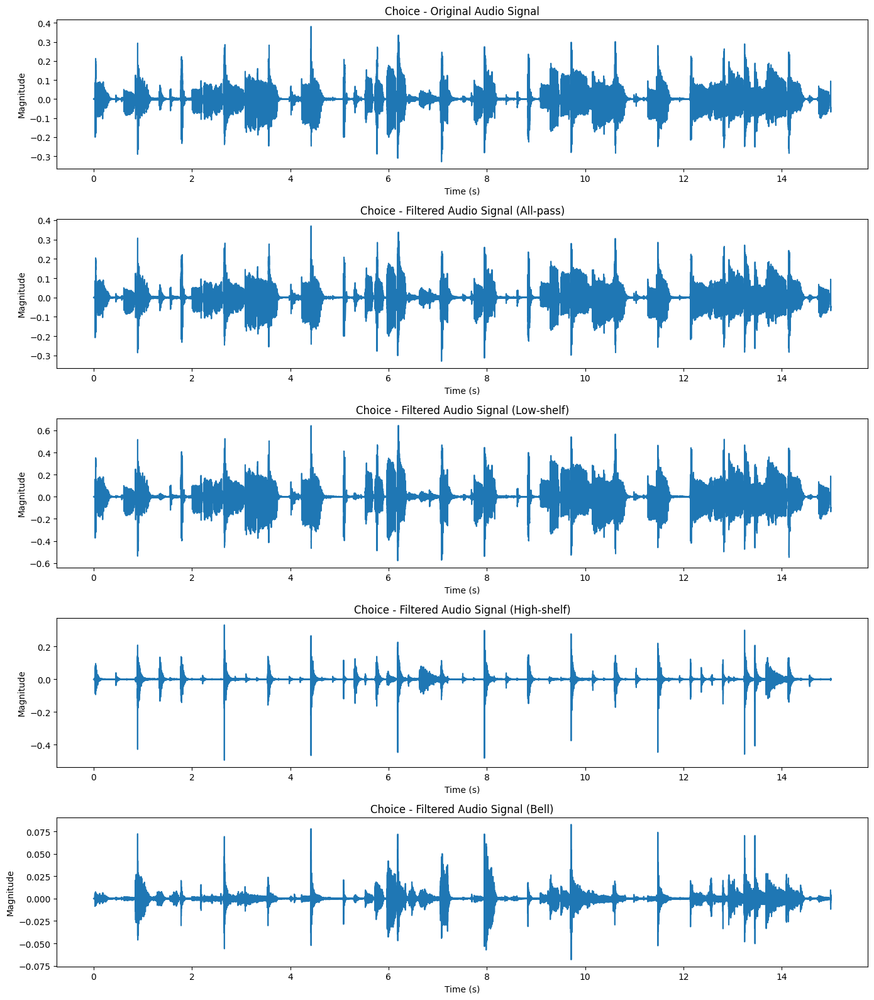

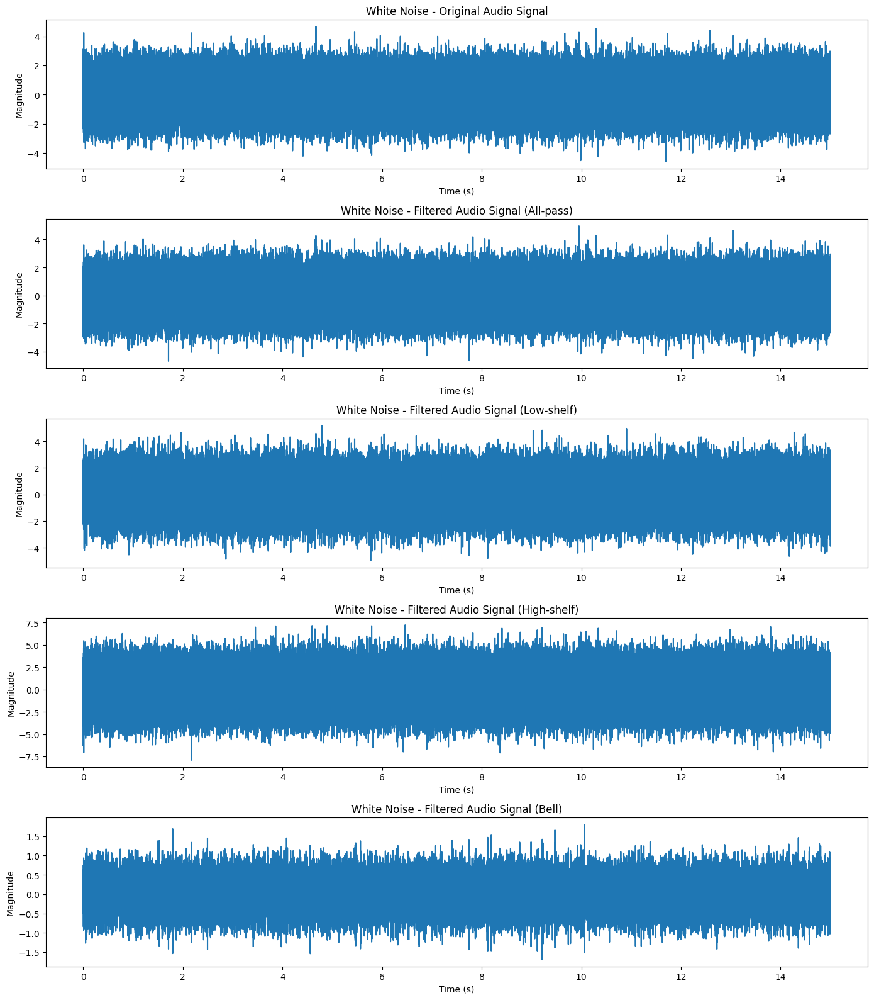

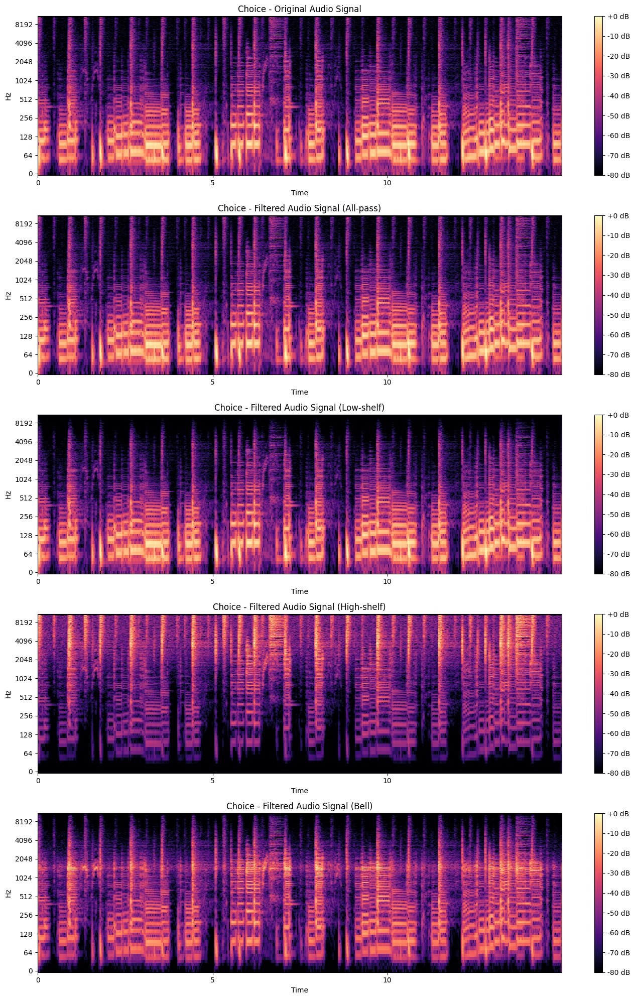

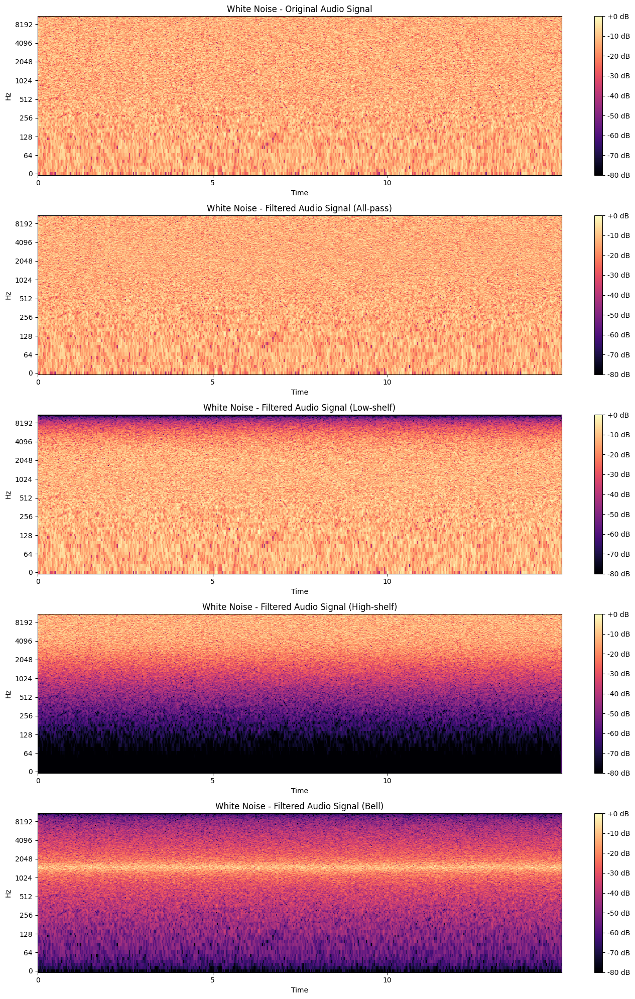

In [7]:
import numpy as np
import matplotlib.pyplot as plt
import librosa
import librosa.display

# Function to visualize the filtered signals
def plot_signals(time, original, filtered_allpass, filtered_shelving_low, filtered_shelving_high, filtered_bell, title):
    plt.figure(figsize=(14, 16))

    plt.subplot(5, 1, 1)
    plt.plot(time, original)
    plt.title(f'{title} - Original Audio Signal')
    plt.xlabel('Time (s)')
    plt.ylabel('Magnitude')

    plt.subplot(5, 1, 2)
    plt.plot(time, filtered_allpass)
    plt.title(f'{title} - Filtered Audio Signal (All-pass)')
    plt.xlabel('Time (s)')
    plt.ylabel('Magnitude')

    plt.subplot(5, 1, 3)
    plt.plot(time, filtered_shelving_low)
    plt.title(f'{title} - Filtered Audio Signal (Low-shelf)')
    plt.xlabel('Time (s)')
    plt.ylabel('Magnitude')

    plt.subplot(5, 1, 4)
    plt.plot(time, filtered_shelving_high)
    plt.title(f'{title} - Filtered Audio Signal (High-shelf)')
    plt.xlabel('Time (s)')
    plt.ylabel('Magnitude')

    plt.subplot(5, 1, 5)
    plt.plot(time, filtered_bell)
    plt.title(f'{title} - Filtered Audio Signal (Bell)')
    plt.xlabel('Time (s)')
    plt.ylabel('Magnitude')

    plt.tight_layout()
    plt.show()

# Function to plot spectrograms
def plot_spectrograms(signals, sr, titles):
    plt.figure(figsize=(14, 20))
    
    for i, (signal, title) in enumerate(zip(signals, titles)):
        plt.subplot(len(signals), 1, i + 1)
        S = librosa.stft(signal)
        S_db = librosa.amplitude_to_db(np.abs(S), ref=np.max)
        librosa.display.specshow(S_db, sr=sr, x_axis='time', y_axis='log')
        plt.colorbar(format='%+2.0f dB')
        plt.title(title)
    
    plt.tight_layout()
    plt.show()

# Calculate the time axis
time1 = np.linspace(0, len(y1) / sr1, len(y1))
time2 = np.linspace(0, len(y3) / sr3, len(y3))

# Original and filtered signals for Choice audio
signals = [y1, filtered_allpass, filtered_shelving_low, filtered_shelving_high, filtered_bell]
titles = [
    'Choice - Original Audio Signal',
    'Choice - Filtered Audio Signal (All-pass)',
    'Choice - Filtered Audio Signal (Low-shelf)',
    'Choice - Filtered Audio Signal (High-shelf)',
    'Choice - Filtered Audio Signal (Bell)'
]

# Original and filtered signals for White Noise
signals2 = [y3, filtered_allpass_wn, filtered_shelving_low_wn, filtered_shelving_high_wn, filtered_bell_wn]
titles2 = [
    'White Noise - Original Audio Signal',
    'White Noise - Filtered Audio Signal (All-pass)',
    'White Noise - Filtered Audio Signal (Low-shelf)',
    'White Noise - Filtered Audio Signal (High-shelf)',
    'White Noise - Filtered Audio Signal (Bell)'
]

# Plot for Choice
plot_signals(time1, y1, filtered_allpass, filtered_shelving_low, filtered_shelving_high, filtered_bell, 'Choice')

# Plot for White Noise
plot_signals(time2, y3, filtered_allpass_wn, filtered_shelving_low_wn, filtered_shelving_high_wn, filtered_bell_wn, 'White Noise')

# Spectrograms for Choice
plot_spectrograms(signals, sr1, titles)

# Spectrograms for White Noise
plot_spectrograms(signals2, sr3, titles2)


# Conclusion
In this notebook, various types of filters (low-pass, high-pass, band-pass, band-stop, shelving, etc.) were applied to both a choice audio sample and white noise. The filters successfully attenuated or boosted specific frequency ranges as per their design. The frequency response plots confirm the expected behavior of the filters, and the time-domain plots of the filtered signals visually demonstrate these effects. Additionally, the spectrograms provide a detailed look into how the energy distribution across frequencies was altered by the filters. These techniques are critical in audio processing applications. 